<a href="https://colab.research.google.com/github/abhishtagatya/paintgan-model-comparison/blob/main/AdaIN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## AdaIN : Adaptive Instance Normalization

![](https://i.imgur.com/JbIfoyE.png)

Gatys et al. recently introduced a neural algorithm that renders a content image in the style of another image, achieving so-called style transfer. However, their framework requires a slow iterative optimization process, which limits its practical application. Fast approximations with feed-forward neural networks have been proposed to speed up neural style transfer. Unfortunately, the speed improvement comes at a cost: the network is usually tied to a fixed set of styles and cannot adapt to arbitrary new styles. In this paper, we present a simple yet effective approach that for the first time enables arbitrary style transfer in real-time. At the heart of our method is a novel adaptive instance normalization (AdaIN) layer that aligns the mean and variance of the content features with those of the style features. Our method achieves speed comparable to the fastest existing approach, without the restriction to a pre-defined set of styles. In addition, our approach allows flexible user controls such as content-style trade-off, style interpolation, color & spatial controls, all using a single feed-forward neural network.

[Paper : Arbitrary Style Transfer in Real-time with Adaptive Instance Normalization](https://paperswithcode.com/paper/arbitrary-style-transfer-in-real-time-with)

### Dataset

```
PaintGAN 80K
Just a sliced dataset of Places365 and WikiArt each containing roughly 80,000 content and style images each.
```







### Prelimenary Setup

Setting up and loading dataset from PaintGAN 80K using Tensorflow DataLoader

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip drive/MyDrive/Dataset/paintgan-80k.zip

Streaming output truncated to the last 5000 lines.
  inflating: paintgan-dataset/wikiart/Realism-vincent-van-gogh_houses-with-thatched-roofs-1884.jpg  
  inflating: paintgan-dataset/wikiart/Cubism-nzante-spee_the-wahdoosee-question-1994.jpg  
  inflating: paintgan-dataset/wikiart/Art_Nouveau_Modern-koloman-moser_postcard-to-carl-moll-ver-sacrum-1897.jpg  
  inflating: paintgan-dataset/wikiart/Realism-pyotr-konchalovsky_daisies-1935-1.jpg  
  inflating: paintgan-dataset/wikiart/Northern_Renaissance-albrecht-durer_head-of-an-old-man-in-profile.jpg  
  inflating: paintgan-dataset/wikiart/Northern_Renaissance-albrecht-durer_lion.jpg  
  inflating: paintgan-dataset/wikiart/Impressionism-theo-van-rysselberghe_standing-nude-1919.jpg  
  inflating: paintgan-dataset/wikiart/Post_Impressionism-henri-de-toulouse-lautrec_not_detected_230533-1882.jpg  
  inflating: paintgan-dataset/wikiart/Impressionism-joaquã­n-sorolla_orchard-house-valencia-study-1908.jpg  
  inflating: paintgan-dataset/wikiart/E

In [3]:
import os
import glob
import imageio
import numpy as np
from tqdm import tqdm
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

#@title ## Model Training Parameters { display-mode: "both" }
#@markdown Change training parameters based on experimentation

# Defining Training Parameters
MODEL_NAME = "AdaIN" #@param{type:"string"}
IMAGE_SIZE = (256, 256) #@param{type:"raw"}
BATCH_SIZE =  32#@param{type:"integer"}
EPOCHS =  30#@param{type:"integer"}
STEPS_PER_EPOCH = 100 #@param{type:"integer"}
CHECKPOINT_PER_EPOCH = 5 #@param{type:"integer"}

AUTOTUNE = tf.data.AUTOTUNE

WIKIART_BASEPATH = "paintgan-dataset/wikiart"
P365_BASEPATH = "paintgan-dataset/places365"

# Loading Image path
content_images = os.listdir(P365_BASEPATH)
content_images = [os.path.join(P365_BASEPATH, path) for path in content_images]

style_images = os.listdir(WIKIART_BASEPATH)
style_images = [os.path.join(WIKIART_BASEPATH, path) for path in style_images]

In [4]:
# Removing corrupted JPEGs on Unzip process (if any)

from struct import unpack

marker_mapping = {
    0xffd8: "Start of Image",
    0xffe0: "Application Default Header",
    0xffdb: "Quantization Table",
    0xffc0: "Start of Frame",
    0xffc4: "Define Huffman Table",
    0xffda: "Start of Scan",
    0xffd9: "End of Image"
}

class JPEG:

    def __init__(self, image_file):
        with open(image_file, 'rb') as f:
            self.img_data = f.read()
    
    def decode(self):
        data = self.img_data
        while(True):
            marker, = unpack(">H", data[0:2])
            if marker == 0xffd8:
                data = data[2:]
            elif marker == 0xffd9:
                return
            elif marker == 0xffda:
                data = data[-2:]
            else:
                lenchunk, = unpack(">H", data[2:4])
                data = data[2+lenchunk:]            
            if len(data)==0:
                break        


corrupted = []

for img in tqdm(style_images):
  image = JPEG(img) 
  try:
    image.decode()   
  except:
    corrupted.append(img)

for name in corrupted:
  style_images.remove(name)

100%|██████████| 80000/80000 [03:44<00:00, 356.55it/s]


In [5]:
# Image Preprocessing
def preprocess_image(image_path, size=IMAGE_SIZE):
  """
    Preprocess the image by decoding and resizing and image 
    from the image file path.

    Args:
      image_path: The image file path.
      size: The size of the image to be resized to.

    Returns:
      image: resized image
  """

  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.image.convert_image_dtype(image, dtype='float32')
  image = tf.image.resize(image, size)

  return image

# Train Test Splits
total_content_images = len(content_images)
train_content = content_images[:int(0.8 * total_content_images)]
val_content = content_images[int(0.8 * total_content_images):int(0.9 * total_content_images)]
test_content = content_images[int(0.9 * total_content_images):]

total_style_images = len(style_images)
train_style = style_images[:int(0.8 * total_style_images)]
val_style = style_images[int(0.8 * total_style_images):int(0.9 * total_style_images)]
test_style = style_images[int(0.9 * total_style_images):]

# Build the style and content tf.data datasets
train_style_ds = (
    tf.data.Dataset.from_tensor_slices(train_style)
    .map(preprocess_image, num_parallel_calls=AUTOTUNE)
    .repeat()
)

val_style_ds = (
    tf.data.Dataset.from_tensor_slices(val_style)
    .map(preprocess_image, num_parallel_calls=AUTOTUNE)
    .repeat()
)

test_style_ds = (
    tf.data.Dataset.from_tensor_slices(test_style)
    .map(preprocess_image, num_parallel_calls=AUTOTUNE)
    .repeat()
)

train_content_ds = (
    tf.data.Dataset.from_tensor_slices(train_content)
    .map(preprocess_image, num_parallel_calls=AUTOTUNE)
    .repeat()
)

val_content_ds = (
    tf.data.Dataset.from_tensor_slices(val_content)
    .map(preprocess_image, num_parallel_calls=AUTOTUNE)
    .repeat()
)

test_content_ds = (
    tf.data.Dataset.from_tensor_slices(test_content)
    .map(preprocess_image, num_parallel_calls=AUTOTUNE)
    .repeat()
)

# Zipping the datasets
train_ds = (
    tf.data.Dataset.zip((train_style_ds, train_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

val_ds = (
    tf.data.Dataset.zip((val_style_ds, val_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

test_ds = (
    tf.data.Dataset.zip((test_style_ds, test_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

### Model Implementation

#### Model Architecture

In [6]:
# Encoder using pretrained VGG

def get_encoder():
  vgg19 = keras.applications.VGG19(
      include_top=False,
      weights="imagenet",
      input_shape=(*IMAGE_SIZE, 3)
  )
  vgg19.trainable = False
  mini_vgg19 = keras.Model(vgg19.input, vgg19.get_layer("block4_conv1").output)

  inputs = keras.layers.Input([*IMAGE_SIZE, 3])
  mini_vgg19_out = mini_vgg19(inputs)

  return keras.Model(
      inputs,
      mini_vgg19_out,
      name="mini_vgg19"
  )

In [7]:
def get_mean_std(x, epsilon=1e-5):
  axes = [1, 2]

  # Compute the mean adn standard deviation of a tensor
  mean, var = tf.nn.moments(x, axes=axes, keepdims=True)
  std_dev = tf.sqrt(var + epsilon)

  return mean, std_dev

def ada_in(style, content):

  """
    Computes the AdaIN feature map

    Args:
      style: The style feature maps
      content: The content feature maps

    Returns:
      t: AdaIN feature map
  """

  content_mean, content_std = get_mean_std(content)
  style_mean, style_std = get_mean_std(style)

  t = style_std * (content - content_mean) / content_std + style_mean

  return t

In [8]:
# Decoder

def get_decoder():
  config = {
      "kernel_size": 3,
      "strides": 1,
      "padding": "same",
      "activation": "relu"
  }

  decoder = keras.Sequential(
      [
       keras.layers.InputLayer((None, None, 512)),
       keras.layers.Conv2D(filters=512, **config),
       keras.layers.UpSampling2D(),
       keras.layers.Conv2D(filters=256, **config),
       keras.layers.Conv2D(filters=256, **config),
       keras.layers.Conv2D(filters=256, **config),
       keras.layers.Conv2D(filters=256, **config),
       keras.layers.UpSampling2D(),
       keras.layers.Conv2D(filters=128, **config),
       keras.layers.Conv2D(filters=128, **config),
       keras.layers.UpSampling2D(),
       keras.layers.Conv2D(filters=64, **config),
       keras.layers.Conv2D(
           filters=3,
           kernel_size=3,
           strides=1,
           padding="same",
           activation="sigmoid",
           ),
      ]
  )

  return decoder

#### Loss Function

In [9]:
def get_loss_net():
  vgg19 = keras.applications.VGG19(
      include_top=False,
      weights="imagenet",
      input_shape=(*IMAGE_SIZE, 3)
  )
  vgg19.trainable = False

  layer_names = [
    "block1_conv1", "block2_conv1", "block3_conv1", "block4_conv1"
  ]
  outputs = [
    vgg19.get_layer(name).output for name in layer_names
  ]
  mini_vgg19 = keras.Model(vgg19.input, outputs)

  inputs = keras.layers.Input([*IMAGE_SIZE, 3])
  mini_vgg19_out = mini_vgg19(inputs)

  return keras.Model(
      inputs,
      mini_vgg19_out,
      name="loss_net"
  )

#### Wrap the Model

In [10]:
class AdaptiveInstanceNorm(tf.keras.Model):

  def __init__(self, encoder, decoder, loss_net, style_weight, **kwargs):
    super().__init__(**kwargs)
    self.encoder = encoder
    self.decoder = decoder
    self.loss_net = loss_net
    self.style_weight = style_weight

  def compile(self, optimizer, loss_fn):
    super().compile()
    self.optimizer = optimizer
    self.loss_fn = loss_fn
    self.style_loss_tracker = keras.metrics.Mean(name="style_loss")
    self.content_loss_tracker = keras.metrics.Mean(name="content_loss")
    self.total_loss_tracker = keras.metrics.Mean(name="total_loss")

  def train_step(self, inputs):
    style, content = inputs

    # Initialize the content and style loss
    loss_content = 0.0
    loss_style = 0.0

    with tf.GradientTape() as tape:
      # Encode the style and content image
      style_encoded = self.encoder(style)
      content_encoded = self.encoder(content)

      # Compute the AdaIN target feature maps
      t = ada_in(style=style_encoded, content=content_encoded)

      # Generate the neural style transferred image
      recon_image = self.decoder(t)

      # Compute the loss
      recon_vgg_features = self.loss_net(recon_image)
      style_vgg_features = self.loss_net(style)
      loss_content = self.loss_fn(t, recon_vgg_features[-1])

      for inp, out in zip(style_vgg_features, recon_vgg_features):
        mean_inp, std_inp = get_mean_std(inp)
        mean_out, std_out = get_mean_std(out)

        loss_style += self.loss_fn(mean_inp, mean_out) + self.loss_fn(std_inp, std_out)
        
      loss_style = self.style_weight * loss_style
      total_loss = loss_content + loss_style
    
    # Compute gradients and optimize the decoder
    trainable_vars = self.decoder.trainable_variables
    gradients = tape.gradient(total_loss, trainable_vars)
    self.optimizer.apply_gradients(zip(gradients, trainable_vars))

    # Update the trackers
    self.style_loss_tracker.update_state(loss_style)
    self.content_loss_tracker.update_state(loss_content)
    self.total_loss_tracker.update_state(total_loss)

    return {
        "style_loss": self.style_loss_tracker.result(),
        "content_loss": self.content_loss_tracker.result(),
        "total_loss": self.total_loss_tracker.result()
    }

  def test_step(self, inputs):
    style, content = inputs

    # Initialize the content and style loss
    loss_content = 0.0
    loss_style = 0.0

    # Encode the style and content
    style_encoded = self.encoder(style)
    content_encoded = self.encoder(content)

    # Compute the AdaIN featue maps
    t = ada_in(style=style_encoded, content=content_encoded)

    # Generate the neural style transferred image
    recon_image = self.decoder(t)

    recon_vgg_features = self.loss_net(recon_image)
    style_vgg_features = self.loss_net(style)
    loss_content = self.loss_fn(t, recon_vgg_features[-1])

    for inp, out in zip(style_vgg_features, recon_vgg_features):
      mean_inp, std_inp = get_mean_std(inp)
      mean_out, std_out = get_mean_std(out)
      loss_style += self.loss_fn(mean_inp, mean_out) + self.loss_fn(
          std_inp, std_out
      )
    loss_style = self.style_weight * loss_style
    total_loss = loss_content + loss_style

    # Update the trackers
    self.style_loss_tracker.update_state(loss_style)
    self.content_loss_tracker.update_state(loss_content)
    self.total_loss_tracker.update_state(total_loss)

    return {
        "style_loss": self.style_loss_tracker.result(),
        "content_loss": self.content_loss_tracker.result(),
        "total_loss": self.total_loss_tracker.result()
    }

  @property
  def metrcis(self):
    return [
            self.style_loss_tracker,
            self.content_loss_tracker,
            self.total_loss_tracker
    ]

### Monitors and Callbacks

In [11]:
!mkdir model_results

In [12]:
test_style, test_content = next(iter(test_ds))

class DisplayMonitor(tf.keras.callbacks.Callback):

  def on_epoch_end(self, epoch, logs=None):
    # Encode the style and content image
    test_style_encoded = self.model.encoder(test_style)
    test_content_encoded = self.model.encoder(test_content)

    test_t = ada_in(style=test_style_encoded, content=test_content_encoded)
    test_recon_image = self.model.decoder(test_t)

    # Plot the style, content, image
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))
    ax[0].imshow(tf.keras.preprocessing.image.array_to_img(test_style[0]))
    ax[0].set_title(f"Style: {epoch+1:03d}")

    ax[1].imshow(tf.keras.preprocessing.image.array_to_img(test_content[0]))
    ax[1].set_title(f"Content: {epoch+1:03d}")

    ax[2].imshow(tf.keras.preprocessing.image.array_to_img(test_recon_image[0]))
    ax[2].set_title(f"{MODEL_NAME}: {epoch+1:03d}")

    plt.savefig(f'model_results/{MODEL_NAME}_{epoch+1}.png', format='png')

    plt.show()
    plt.close()

In [13]:
!mkdir model_checkpoints

In [14]:
class CheckpointMonitor(tf.keras.callbacks.Callback):

  def on_epoch_end(self, epoch, logs=None):
    # Saving model checkpoint
    if (epoch+1) % CHECKPOINT_PER_EPOCH == 0:
      self.model.save_weights(f'model_checkpoints/{MODEL_NAME}_{epoch+1}.ckpt')

In [15]:
csv_logger = keras.callbacks.CSVLogger(f'{MODEL_NAME}_p365-{EPOCHS}-{BATCH_SIZE}.csv', append=True, separator=';')

In [16]:
callbacks = [
  DisplayMonitor(),
  CheckpointMonitor(),
  csv_logger
]

80150528/80134624 [==============================] - 1s 0us/step
Epoch 1/30
100/100 [==============================] - ETA: 0s - style_loss: 183.1359 - content_loss: 128.4363 - total_loss: 311.5721

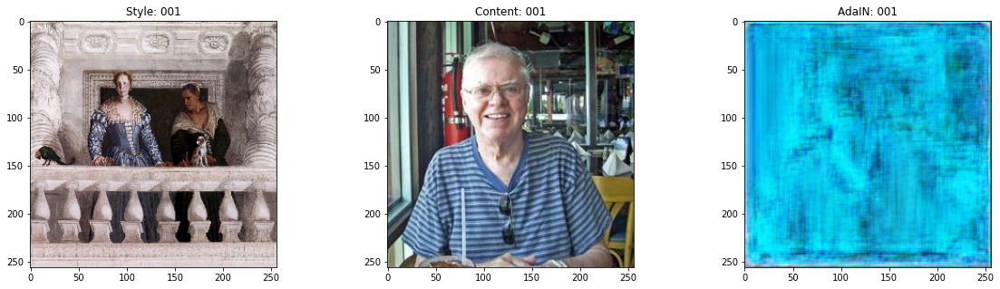

100/100 [==============================] - 155s 1s/step - style_loss: 183.1359 - content_loss: 128.4363 - total_loss: 311.5721 - val_style_loss: 141.1027 - val_content_loss: 113.5458 - val_total_loss: 254.6485
Epoch 2/30
100/100 [==============================] - ETA: 0s - style_loss: 123.7205 - content_loss: 106.9657 - total_loss: 230.6862

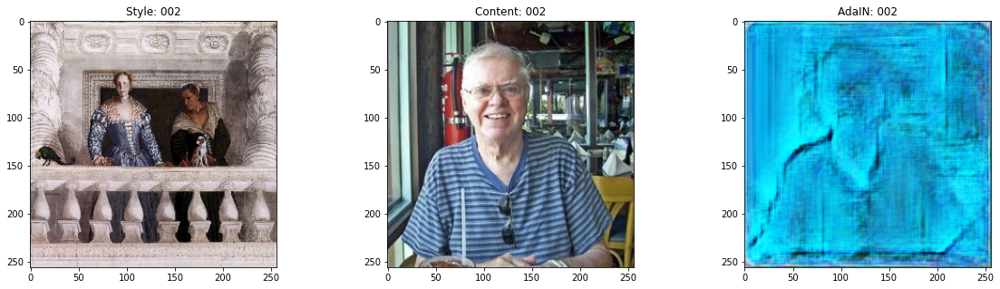

100/100 [==============================] - 135s 1s/step - style_loss: 123.7205 - content_loss: 106.9657 - total_loss: 230.6862 - val_style_loss: 108.3109 - val_content_loss: 100.7907 - val_total_loss: 209.1016
Epoch 3/30
100/100 [==============================] - ETA: 0s - style_loss: 98.8737 - content_loss: 96.2509 - total_loss: 195.1247

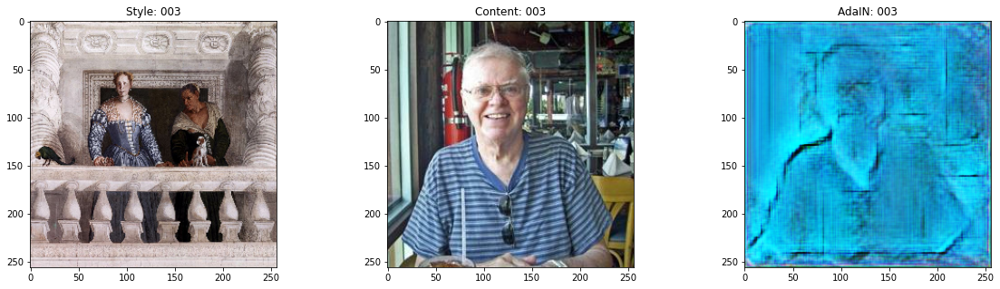

100/100 [==============================] - 136s 1s/step - style_loss: 98.8737 - content_loss: 96.2509 - total_loss: 195.1247 - val_style_loss: 90.4273 - val_content_loss: 90.9515 - val_total_loss: 181.3788
Epoch 4/30
100/100 [==============================] - ETA: 0s - style_loss: 80.9866 - content_loss: 86.9879 - total_loss: 167.9745

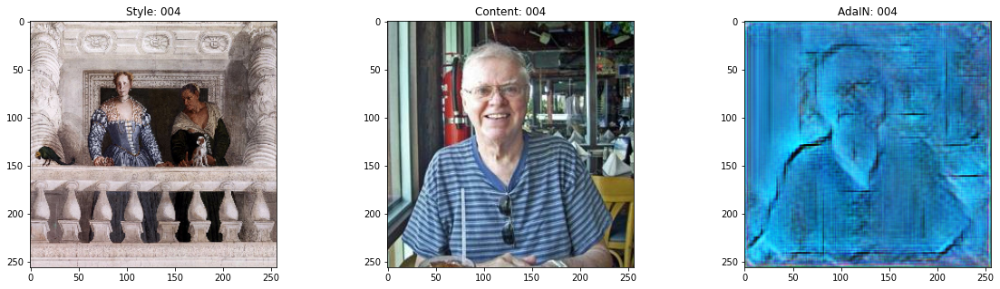

100/100 [==============================] - 135s 1s/step - style_loss: 80.9866 - content_loss: 86.9879 - total_loss: 167.9745 - val_style_loss: 76.1714 - val_content_loss: 84.5929 - val_total_loss: 160.7643
Epoch 5/30
100/100 [==============================] - ETA: 0s - style_loss: 71.8176 - content_loss: 82.5670 - total_loss: 154.3846

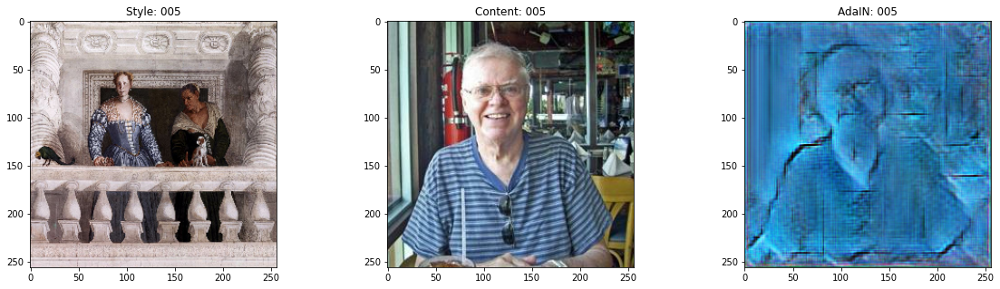

100/100 [==============================] - 136s 1s/step - style_loss: 71.8176 - content_loss: 82.5670 - total_loss: 154.3846 - val_style_loss: 65.9821 - val_content_loss: 79.4341 - val_total_loss: 145.4162
Epoch 6/30
100/100 [==============================] - ETA: 0s - style_loss: 63.1406 - content_loss: 77.9747 - total_loss: 141.1154

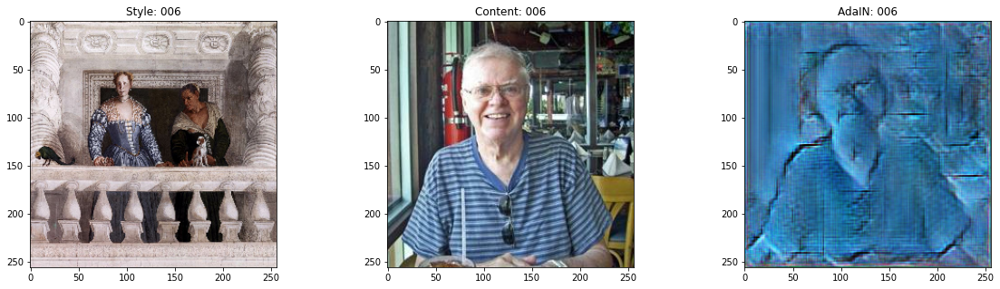

100/100 [==============================] - 135s 1s/step - style_loss: 63.1406 - content_loss: 77.9747 - total_loss: 141.1154 - val_style_loss: 58.4156 - val_content_loss: 75.1683 - val_total_loss: 133.5838
Epoch 7/30
100/100 [==============================] - ETA: 0s - style_loss: 55.5006 - content_loss: 72.8134 - total_loss: 128.3139

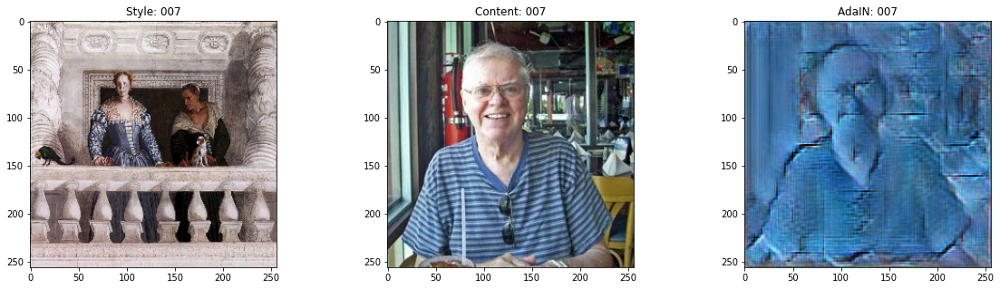

100/100 [==============================] - 136s 1s/step - style_loss: 55.5006 - content_loss: 72.8134 - total_loss: 128.3139 - val_style_loss: 52.2143 - val_content_loss: 71.5233 - val_total_loss: 123.7377
Epoch 8/30
100/100 [==============================] - ETA: 0s - style_loss: 49.5766 - content_loss: 69.4450 - total_loss: 119.0216

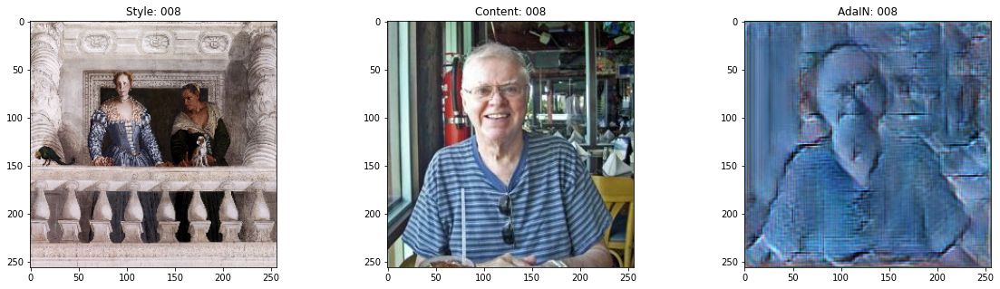

100/100 [==============================] - 135s 1s/step - style_loss: 49.5766 - content_loss: 69.4450 - total_loss: 119.0216 - val_style_loss: 48.3541 - val_content_loss: 67.9953 - val_total_loss: 116.3494
Epoch 9/30
100/100 [==============================] - ETA: 0s - style_loss: 45.8536 - content_loss: 67.2528 - total_loss: 113.1064

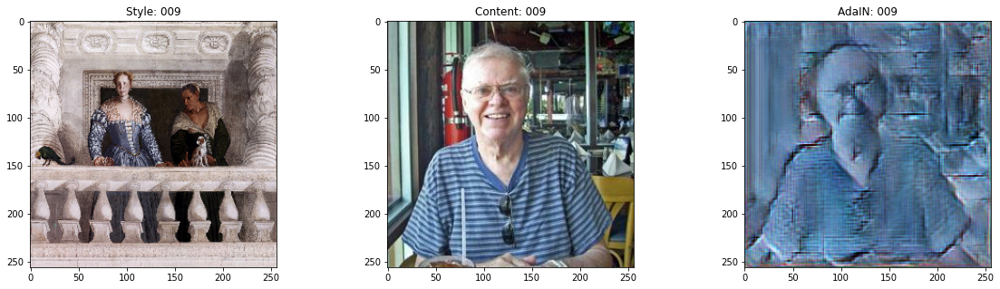

100/100 [==============================] - 136s 1s/step - style_loss: 45.8536 - content_loss: 67.2528 - total_loss: 113.1064 - val_style_loss: 43.7714 - val_content_loss: 66.1495 - val_total_loss: 109.9210
Epoch 10/30
100/100 [==============================] - ETA: 0s - style_loss: 42.9087 - content_loss: 64.9019 - total_loss: 107.8106

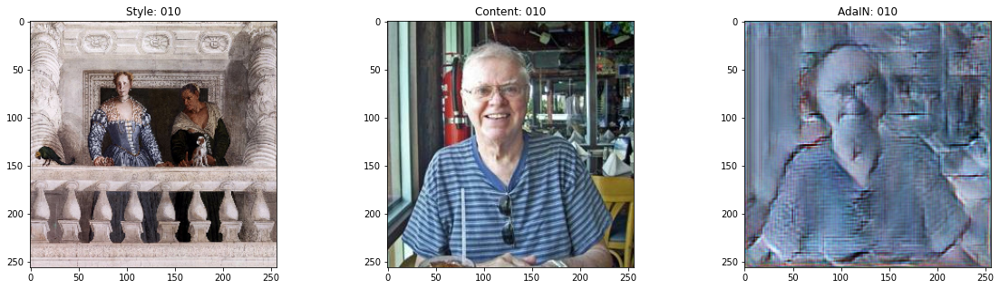

100/100 [==============================] - 136s 1s/step - style_loss: 42.9087 - content_loss: 64.9019 - total_loss: 107.8106 - val_style_loss: 41.0368 - val_content_loss: 62.9899 - val_total_loss: 104.0267
Epoch 11/30
100/100 [==============================] - ETA: 0s - style_loss: 39.5539 - content_loss: 63.0399 - total_loss: 102.5938

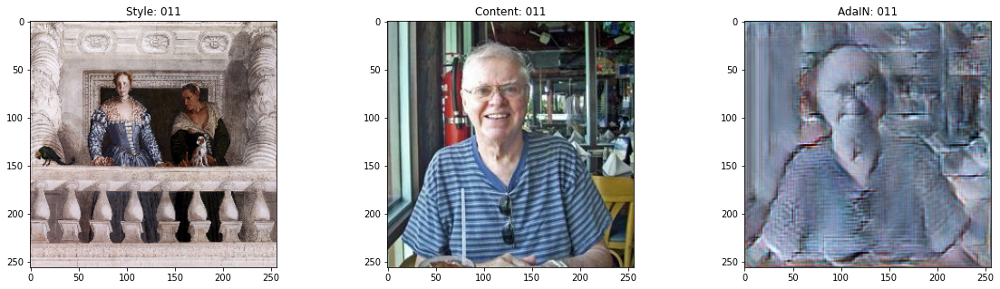

100/100 [==============================] - 135s 1s/step - style_loss: 39.5539 - content_loss: 63.0399 - total_loss: 102.5938 - val_style_loss: 38.2093 - val_content_loss: 61.7940 - val_total_loss: 100.0033
Epoch 12/30
100/100 [==============================] - ETA: 0s - style_loss: 37.2899 - content_loss: 61.2423 - total_loss: 98.5321

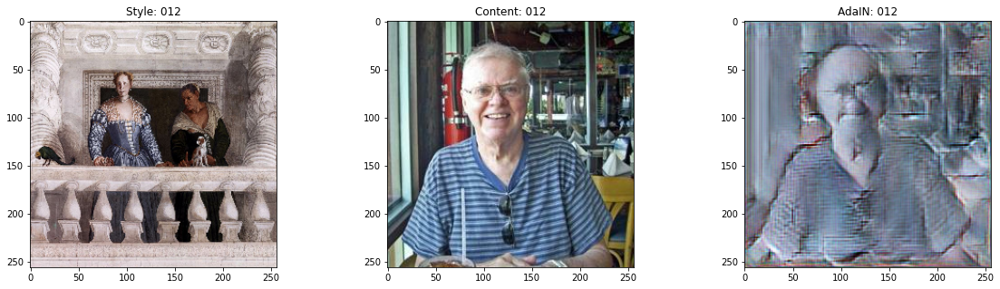

100/100 [==============================] - 136s 1s/step - style_loss: 37.2899 - content_loss: 61.2423 - total_loss: 98.5321 - val_style_loss: 35.9669 - val_content_loss: 60.4612 - val_total_loss: 96.4281
Epoch 13/30
100/100 [==============================] - ETA: 0s - style_loss: 34.5655 - content_loss: 59.0779 - total_loss: 93.6435

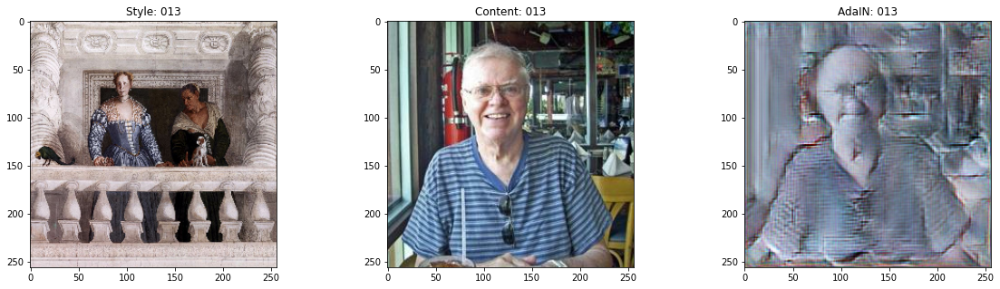

100/100 [==============================] - 135s 1s/step - style_loss: 34.5655 - content_loss: 59.0779 - total_loss: 93.6435 - val_style_loss: 34.8556 - val_content_loss: 58.4795 - val_total_loss: 93.3351
Epoch 14/30
100/100 [==============================] - ETA: 0s - style_loss: 33.8430 - content_loss: 57.4452 - total_loss: 91.2882

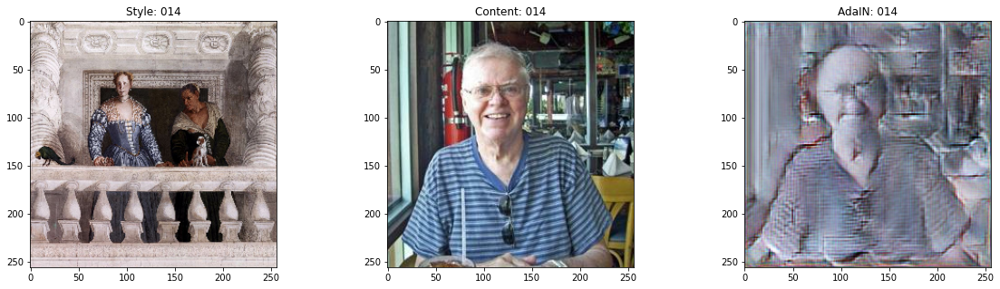

100/100 [==============================] - 135s 1s/step - style_loss: 33.8430 - content_loss: 57.4452 - total_loss: 91.2882 - val_style_loss: 33.0494 - val_content_loss: 57.7840 - val_total_loss: 90.8334
Epoch 15/30
100/100 [==============================] - ETA: 0s - style_loss: 32.5485 - content_loss: 56.7779 - total_loss: 89.3265

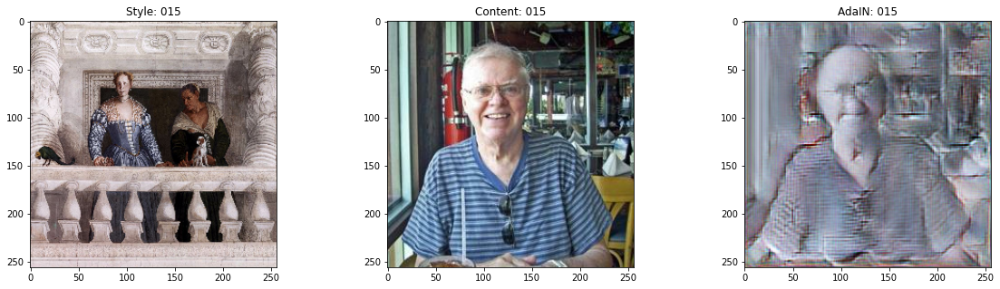

100/100 [==============================] - 136s 1s/step - style_loss: 32.5485 - content_loss: 56.7779 - total_loss: 89.3265 - val_style_loss: 32.8496 - val_content_loss: 56.3953 - val_total_loss: 89.2449
Epoch 16/30
100/100 [==============================] - ETA: 0s - style_loss: 32.1657 - content_loss: 56.3480 - total_loss: 88.5137

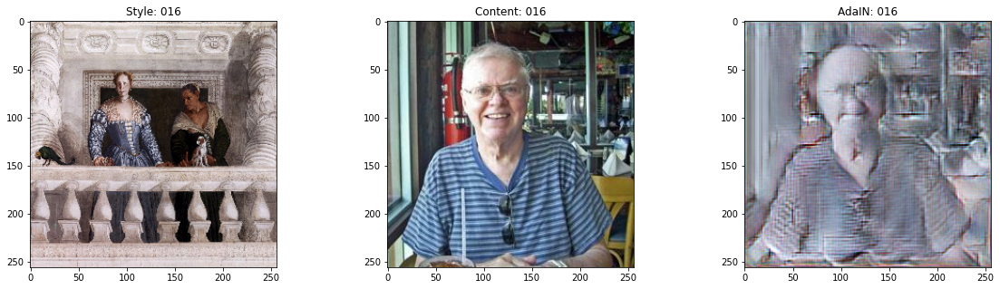

100/100 [==============================] - 135s 1s/step - style_loss: 32.1657 - content_loss: 56.3480 - total_loss: 88.5137 - val_style_loss: 31.3707 - val_content_loss: 55.8620 - val_total_loss: 87.2327
Epoch 17/30
100/100 [==============================] - ETA: 0s - style_loss: 30.7344 - content_loss: 54.9726 - total_loss: 85.7070

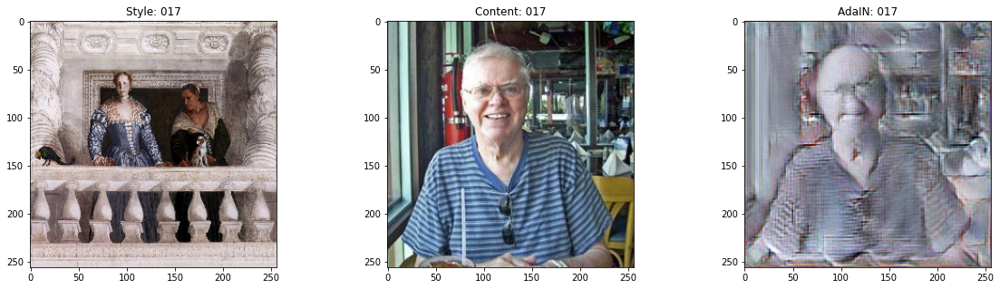

100/100 [==============================] - 136s 1s/step - style_loss: 30.7344 - content_loss: 54.9726 - total_loss: 85.7070 - val_style_loss: 30.3513 - val_content_loss: 54.4571 - val_total_loss: 84.8084
Epoch 18/30
100/100 [==============================] - ETA: 0s - style_loss: 29.9584 - content_loss: 54.0711 - total_loss: 84.0295

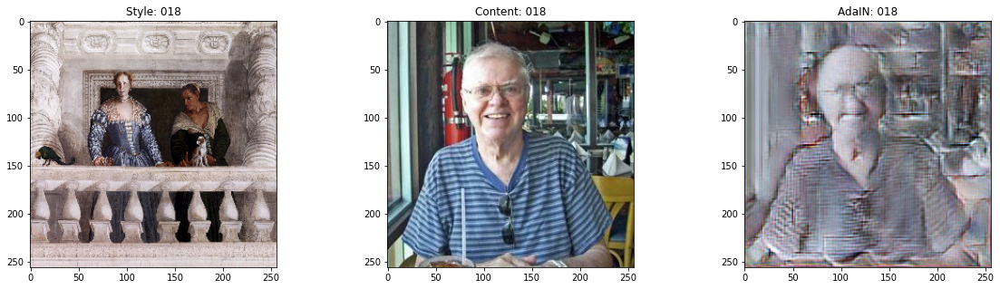

100/100 [==============================] - 136s 1s/step - style_loss: 29.9584 - content_loss: 54.0711 - total_loss: 84.0295 - val_style_loss: 29.5843 - val_content_loss: 53.9655 - val_total_loss: 83.5499
Epoch 19/30
100/100 [==============================] - ETA: 0s - style_loss: 28.7285 - content_loss: 53.0903 - total_loss: 81.8188

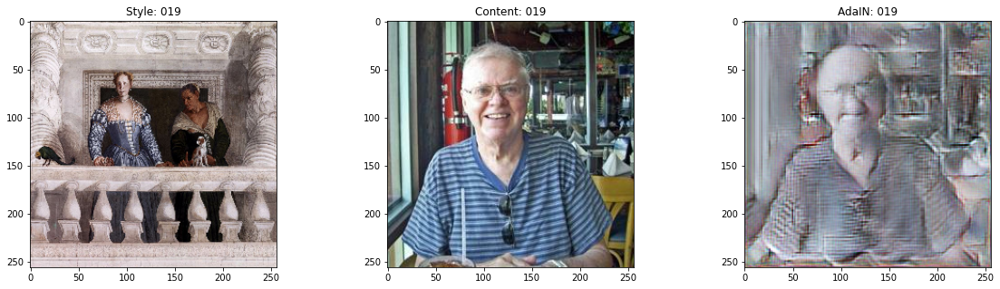

100/100 [==============================] - 135s 1s/step - style_loss: 28.7285 - content_loss: 53.0903 - total_loss: 81.8188 - val_style_loss: 29.0106 - val_content_loss: 52.6802 - val_total_loss: 81.6908
Epoch 20/30
100/100 [==============================] - ETA: 0s - style_loss: 28.8651 - content_loss: 53.0095 - total_loss: 81.8747

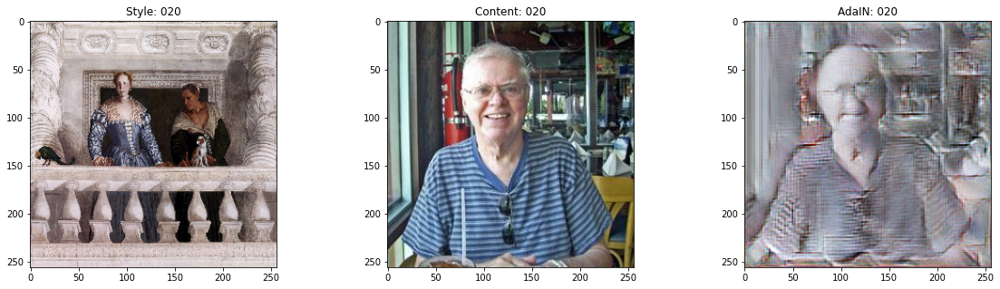

100/100 [==============================] - 136s 1s/step - style_loss: 28.8651 - content_loss: 53.0095 - total_loss: 81.8747 - val_style_loss: 28.2701 - val_content_loss: 52.2852 - val_total_loss: 80.5552
Epoch 21/30
100/100 [==============================] - ETA: 0s - style_loss: 28.5735 - content_loss: 52.7952 - total_loss: 81.3688

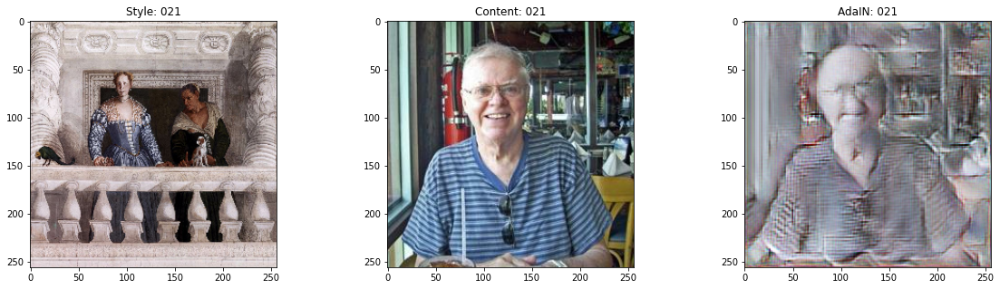

100/100 [==============================] - 136s 1s/step - style_loss: 28.5735 - content_loss: 52.7952 - total_loss: 81.3688 - val_style_loss: 27.3213 - val_content_loss: 51.7800 - val_total_loss: 79.1013
Epoch 22/30
100/100 [==============================] - ETA: 0s - style_loss: 27.1835 - content_loss: 51.6389 - total_loss: 78.8224

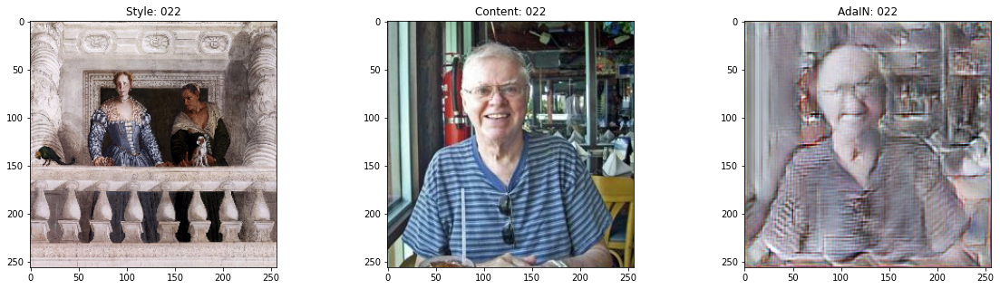

100/100 [==============================] - 136s 1s/step - style_loss: 27.1835 - content_loss: 51.6389 - total_loss: 78.8224 - val_style_loss: 26.9068 - val_content_loss: 51.6384 - val_total_loss: 78.5451
Epoch 23/30
100/100 [==============================] - ETA: 0s - style_loss: 26.9638 - content_loss: 50.8811 - total_loss: 77.8449

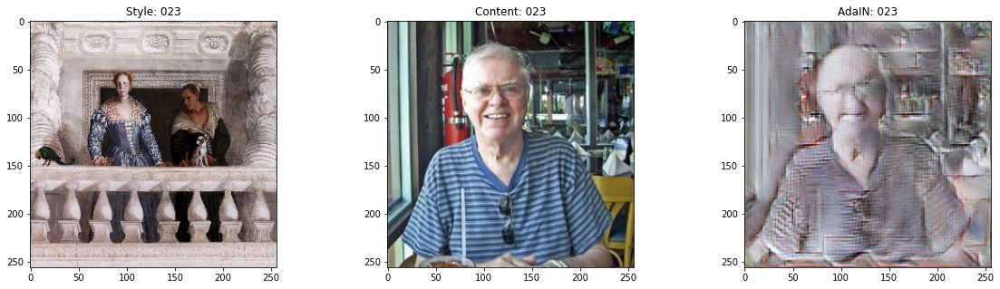

100/100 [==============================] - 136s 1s/step - style_loss: 26.9638 - content_loss: 50.8811 - total_loss: 77.8449 - val_style_loss: 26.8363 - val_content_loss: 50.4840 - val_total_loss: 77.3203
Epoch 24/30
100/100 [==============================] - ETA: 0s - style_loss: 26.0217 - content_loss: 49.3691 - total_loss: 75.3908

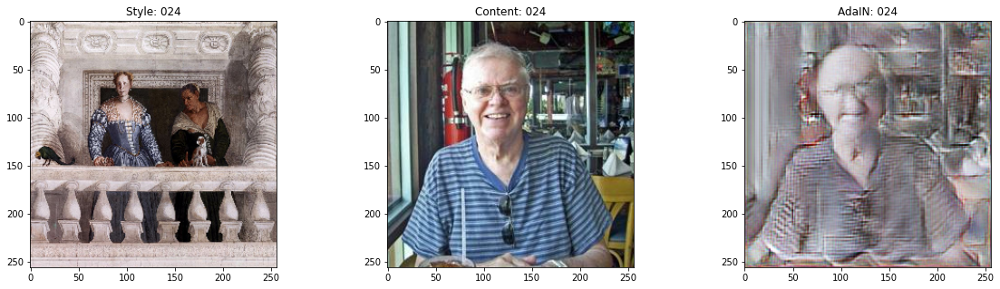

100/100 [==============================] - 136s 1s/step - style_loss: 26.0217 - content_loss: 49.3691 - total_loss: 75.3908 - val_style_loss: 26.3431 - val_content_loss: 50.1155 - val_total_loss: 76.4586
Epoch 25/30
100/100 [==============================] - ETA: 0s - style_loss: 26.6933 - content_loss: 50.6535 - total_loss: 77.3467

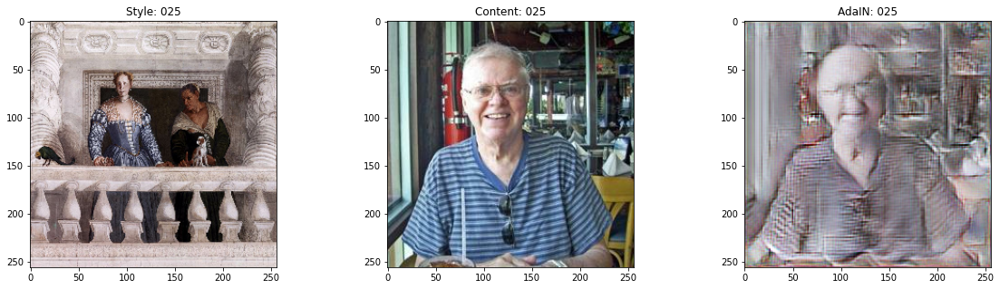

100/100 [==============================] - 136s 1s/step - style_loss: 26.6933 - content_loss: 50.6535 - total_loss: 77.3467 - val_style_loss: 26.5329 - val_content_loss: 48.9615 - val_total_loss: 75.4944
Epoch 26/30
100/100 [==============================] - ETA: 0s - style_loss: 26.0985 - content_loss: 49.4957 - total_loss: 75.5942

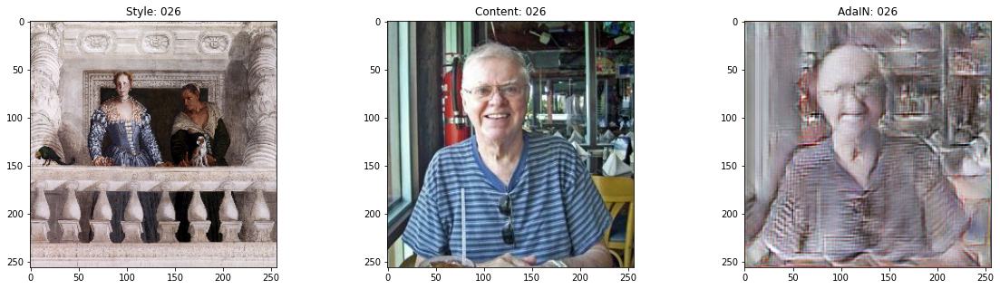

100/100 [==============================] - 136s 1s/step - style_loss: 26.0985 - content_loss: 49.4957 - total_loss: 75.5942 - val_style_loss: 25.5789 - val_content_loss: 48.9283 - val_total_loss: 74.5071
Epoch 27/30
100/100 [==============================] - ETA: 0s - style_loss: 25.8592 - content_loss: 48.8693 - total_loss: 74.7285

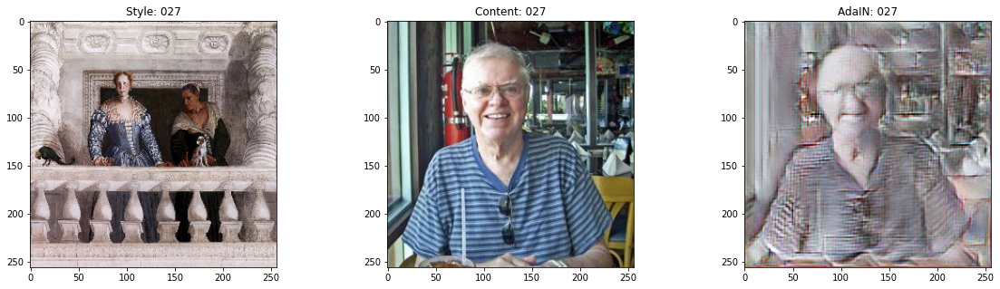

100/100 [==============================] - 136s 1s/step - style_loss: 25.8592 - content_loss: 48.8693 - total_loss: 74.7285 - val_style_loss: 24.8153 - val_content_loss: 49.4103 - val_total_loss: 74.2256
Epoch 28/30
100/100 [==============================] - ETA: 0s - style_loss: 24.9218 - content_loss: 48.2516 - total_loss: 73.1734

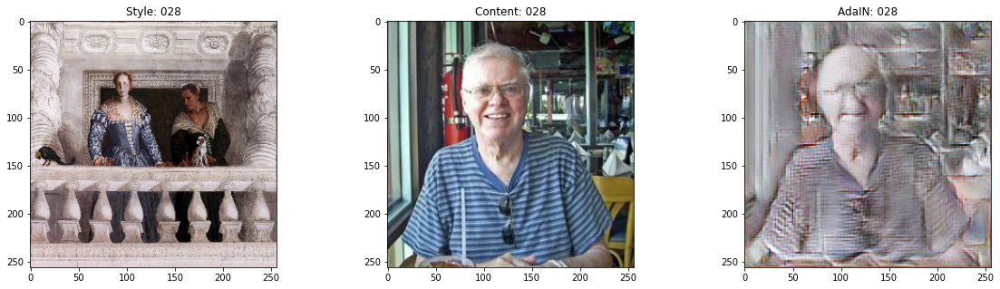

100/100 [==============================] - 136s 1s/step - style_loss: 24.9218 - content_loss: 48.2516 - total_loss: 73.1734 - val_style_loss: 24.8136 - val_content_loss: 48.1715 - val_total_loss: 72.9851
Epoch 29/30
100/100 [==============================] - ETA: 0s - style_loss: 24.6910 - content_loss: 48.1173 - total_loss: 72.8084

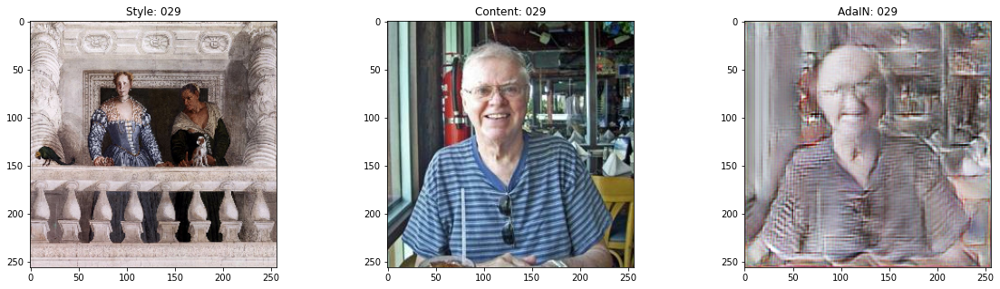

100/100 [==============================] - 136s 1s/step - style_loss: 24.6910 - content_loss: 48.1173 - total_loss: 72.8084 - val_style_loss: 24.3309 - val_content_loss: 48.1127 - val_total_loss: 72.4436
Epoch 30/30
100/100 [==============================] - ETA: 0s - style_loss: 24.7018 - content_loss: 47.7340 - total_loss: 72.4358

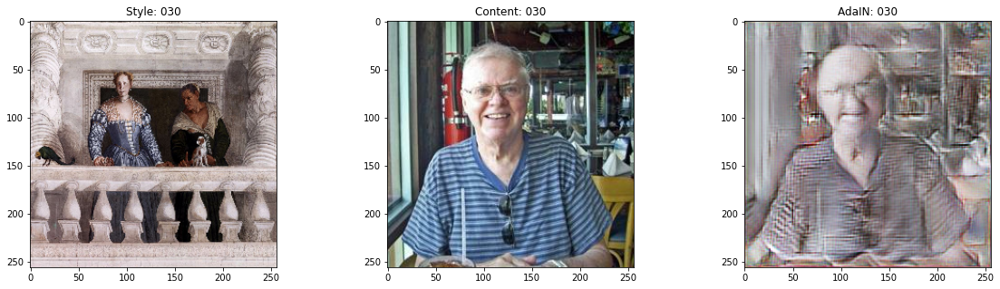

100/100 [==============================] - 136s 1s/step - style_loss: 24.7018 - content_loss: 47.7340 - total_loss: 72.4358 - val_style_loss: 24.0194 - val_content_loss: 47.5692 - val_total_loss: 71.5886


In [17]:
optimizer = keras.optimizers.Adam(learning_rate=1e-5)
loss_fn = keras.losses.MeanSquaredError()

encoder = get_encoder()
loss_net = get_loss_net()
decoder = get_decoder()

model = AdaptiveInstanceNorm(
    encoder=encoder, decoder=decoder, loss_net=loss_net, style_weight=4.0
)

model.compile(optimizer=optimizer, loss_fn=loss_fn)

history = model.fit(
    train_ds,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    validation_data=val_ds,
    validation_steps=STEPS_PER_EPOCH,
    callbacks=callbacks
)

### Result

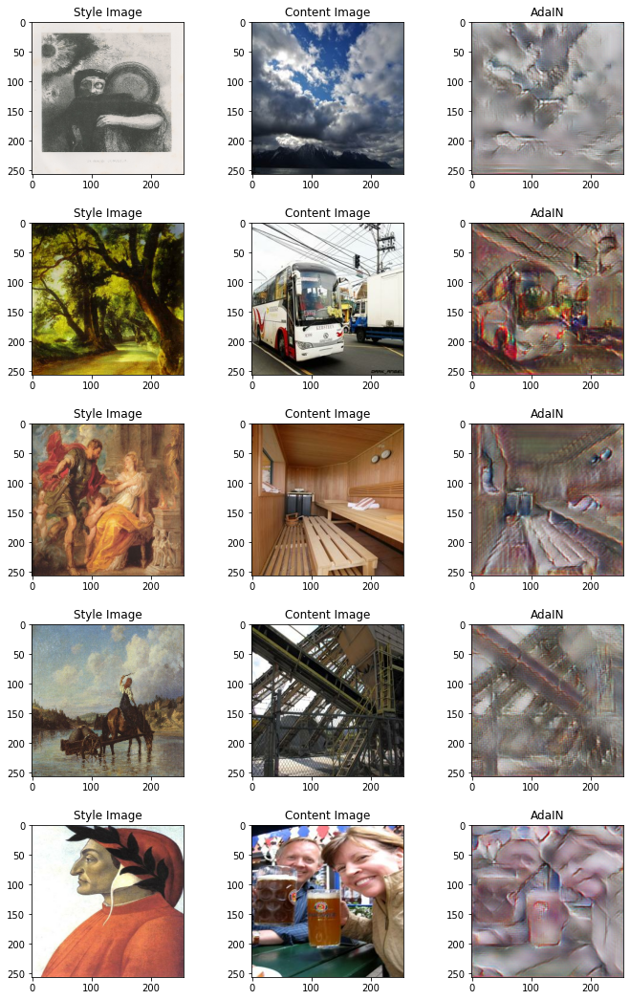

In [18]:
for style, content in test_ds.take(1):
  style_encoded = model.encoder(style)
  content_encoded = model.encoder(content)
  t = ada_in(style=style_encoded, content=content_encoded)
  recon_image = model.decoder(t)
  fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(10, 15))
  fig.tight_layout(pad=3.0)

  for axis, style_image, content_image, recon_img in zip(
      axes, style[0:5], content[0:5], recon_image[0:5]
  ):
    (ax_style, ax_content, ax_recon) = axis
    ax_style.imshow(style_image)
    ax_style.set_title("Style Image")
    
    ax_content.imshow(content_image)
    ax_content.set_title("Content Image")

    ax_recon.imshow(recon_img)
    ax_recon.set_title(f"{MODEL_NAME}")

In [23]:
# Build GIF

import glob
from PIL import Image

fpath = "model_results/{MODEL_NAME}_{EPOCH}.png"
fout = f"{MODEL_NAME}_{EPOCHS}.gif"

imgs = []
for i in range(EPOCHS):
  imgs.append(Image.open(fpath.format(MODEL_NAME=MODEL_NAME, EPOCH=i+1)))

imgs = iter(imgs)
img = next(imgs)
img.save(fp=fout, format='GIF', append_images=imgs,
         save_all=True, duration=200, loop=0)

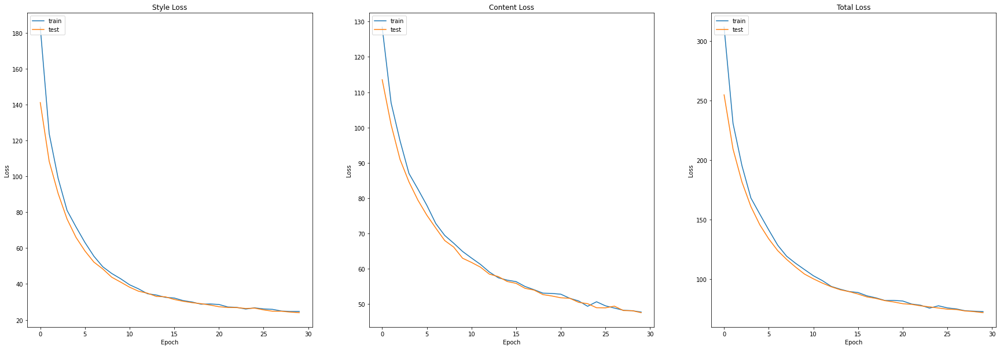

In [33]:
fig, axs = plt.subplots(1, 3, figsize=(30, 10))

axs[0].plot(history.history['style_loss'])
axs[0].plot(history.history['val_style_loss'])
axs[0].set_title('Style Loss')
axs[0].set_ylabel('Loss')
axs[0].set_xlabel('Epoch')
axs[0].legend(['train', 'test'], loc='upper left')

axs[1].plot(history.history['content_loss'])
axs[1].plot(history.history['val_content_loss'])
axs[1].set_title('Content Loss')
axs[1].set_ylabel('Loss')
axs[1].set_xlabel('Epoch')
axs[1].legend(['train', 'test'], loc='upper left')

axs[2].plot(history.history['total_loss'])
axs[2].plot(history.history['val_total_loss'])
axs[2].set_title('Total Loss')
axs[2].set_ylabel('Loss')
axs[2].set_xlabel('Epoch')
axs[2].legend(['train', 'test'], loc='upper left')

plt.show()